**ABSTRACT**
> The main target of this project is to create and train a model to be able to detect humans in crowded scenarios. An object detection model known as YOLO (You only look once) has used for this task and was trained on CrowdHuman dataset which was specifically created for this purpose. Initial EDA was performed on the data and then YOLOv4 model was trained on this dataset and the evaluation was done by looking at accuracy, training loss and mAP scores. 



**Overview and motivation**
> Goal: 
*   To train model to detect humans in crowded scenarios

> Motivation:
*   Aid in navigation of robots among humans
*   Sensor fusion: Use the model to generate sensor data which can be used with other sensor data to aid in motion planning
*   To analyze how good can a model be trained for large crowd scenarios

**Related Work**



> **Inspiration**: I was working on my capstone where a robot had to navigate among humans and I was already interested in deep learning networks and had worked on them a bit and so I wanted to know how good a model can be trained to detect humans in crowded scenarios and so I chose this project.


> A paper by [Shuai Shao et al.](https://doi.org/10.48550/arXiv.1805.00123) was published where the authors created a dataset specifacally for training models for detection in crowded scenarios and thus helping more in this project by saving the time on finding good dataset.







**Initial Questions**


*   How effective can be a model to detect humans in crowded scenarios?
*   Which model should be used, trading off between speed, complexity, training time etc?
*   How effectively can this model be used with other sensor data?

Last question was dropped as we would need more time and is little bit out of this course and hence I decided to work on solving the first two questions.
The performance of the model was evaluated by measuring the training loss and mAP. Selecting which model to use decided by the seeing the latest versions of YOLO models of which v7 was the recent one, but I was struggling implementing that so I shifted to v4 and v5. Since v5 was already implemented by Ultralytics, I decided to use that as a test bench against v4 which was implemented by me. I also got some reference code on github, along with the architecture provided by the darknet meant that it was possible for me to do v4 under the time constraints. 



**Data**



> **Source**: [CrowdHuman](https://www.crowdhuman.org/) dataset was provided by Shuai Shao et al. for better evaluate detectors in crowd scenarios. 

> **Format**: The training, validation and test data is in zip format with total of five files namely, CrowdHuman_train01.zip, CrowdHuman_train02.zip, CrowdHuman_train03.zip, CrowdHuman_val.zip, CrowdHuman_test.zip and the labels for training and validation dataset are in .odgt format namely, annotation_train.odgt, annotation_val.odgt
It has high diverse images with annotations. There are total of 470,000 human instances including both training and validation set with maximum of 23 persons per image and human instance is annotated with bounding box for head, human visible region, and human full body.

* Training set – 15,000 images
* Validation set – 4370 images
* Testing set – 5000 images

> **Storage**: The data is stored on my personal google drive 



> **Exploratory Data Analysis**: Following EDA were performed on the dataset to further understand and analyze the properties of data and how to use them to train the model:

In [ ]:
# Mount google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Name of the directory on Google Drive for saving training log, loss/mAP chart, and weights
SAVE_DIR = 'YOLOv4_CrowdHuman'

# Path of the Google Drive mount point
DRIVE_DIR = '/content/drive/My Drive'

# Full path to the save directory on Google Drive
DRIVE_SAVE_DIR = DRIVE_DIR + '/' + SAVE_DIR

# Input shape {width}*{height} of the yolov4 model to be trained
INPUT_SHAPE = '416x416'

In [ ]:
# Check GPU allocated
! nvidia-smi

Fri Dec 16 14:13:21 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  A100-SXM4-40GB      Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    51W / 400W |      0MiB / 40536MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from pathlib import Path

# Clone the github repo
%cd /content
if not Path('YOLOv4_CrowdHuman').is_dir():
    !git clone https://github.com/febinfredi/Detection-and-Tracking-of-Humans-in-Crowded-Scenarios.git

/content
Cloning into 'YOLOv4_CrowdHuman'...
remote: Enumerating objects: 43, done.
remote: Counting objects: 100% (43/43), done.
remote: Compressing objects: 100% (41/41), done.
remote: Total 43 (delta 19), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (43/43), done.


**Prepare data**
> Now this step is to prepare the data for training by running prepare_data.sh sell script


```
#!/bin/bash

set -e

# check argument
if [[ -z $1 || ! $1 =~ [[:digit:]]x[[:digit:]] ]]; then
  echo "ERROR: This script requires 1 argument, \"input dimension\" of the YOLO model."
  echo "The input dimension should be {width}x{height}".
  exit 1
fi

if which python3 > /dev/null; then
  PYTHON=python3
else
  PYTHON=python
fi

echo "** Install requirements"
# "gdown" is for downloading files from GoogleDrive
pip3 install --user gdown > /dev/null
pip3 install --upgrade gdown > /dev/null

# make sure to download dataset files to "YOLOv4_CrowdHuman/data/raw/"
mkdir -p $(dirname $0)/raw
pushd $(dirname $0)/raw > /dev/null

get_file()
{
  # do download only if the file does not exist
  if [[ -f $2 ]];  then
    echo Skipping $2
  else
    echo Downloading $2...
    python3 -m gdown.cli $1
  fi
}

echo "** Download dataset files"
# train set
gdown https://drive.google.com/uc?id=1YH6GRiicbvCmEzH1DJG9YDyI48QO66Vw
gdown https://drive.google.com/uc?id=1jpBn27IxgVFTWraIqeHddqHU_5Z_wWGj
gdown https://drive.google.com/uc?id=1UX0Q0-yhlKaCJkrpRbB5Fz7uAYAR-sej
# val set
gdown https://drive.google.com/uc?id=1oBIV33q9d2xg0XwSb6hRWYuVPFyMhCCr
# .odgt files
gdown https://drive.google.com/uc?id=1EvdshfVnj91NniHgAkCrNEBL9nm9XIKD
gdown https://drive.google.com/uc?id=1UFXXygn0yKbBrPvhbpcANS5O0SptAg8n

# unzip image files (ignore CrowdHuman_test.zip for now)
echo "** Unzip dataset files"
for f in CrowdHuman_train01.zip CrowdHuman_train02.zip CrowdHuman_train03.zip CrowdHuman_val.zip ; do
  unzip -n ${f}
done

echo "** Create the crowdhuman-$1/ subdirectory"
rm -rf ../crowdhuman-$1/
mkdir ../crowdhuman-$1/
ln Images/*.jpg ../crowdhuman-$1/

# the crowdhuman/ subdirectory now contains all train/val jpg images

echo "** Generate yolo txt files"
cd ..
${PYTHON} gen_txts.py $1

popd > /dev/null

echo "** Done."
```

* First we download and install gdown to download training and validation and .odgt from drive
* Then we unzip images into crowdhuman-416x416 folder
* Then we run gen_txtx.py files which outputs
    * train.txt
    * test.txt
    * [image name].txt which is one annotation for each image in the training and test set





In [ ]:
# Download datasets and install required package (gdown: used for downloading data from google drive)
%cd /content/YOLOv4_CrowdHuman/data
! chmod +x prepare_data.sh
!./prepare_data.sh {INPUT_SHAPE}

Streaming output truncated to the last 5000 lines.
Processing ID: 283647,1644d000ec93d8b4
Processing ID: 282555,11095e0000a0154f9
Processing ID: 282555,19ec300061bfd9e9
Processing ID: 273278,3dde4000263464b7
Processing ID: 282555,1200670007d50295b
Processing ID: 284193,1cc57000009322d5
Processing ID: 273278,c6eda0007fb9380f
Processing ID: 282555,33ff100035776f08
Processing ID: 273275,921ab0003e5e0914
Processing ID: 273275,6aeaa0005bd1ebea
Processing ID: 282555,1215c0000c2b2adb2
Processing ID: 282555,bbf810006c43fac8
Processing ID: 273278,b5d16000011d18a1
Processing ID: 273278,76f8900018333c49
Processing ID: 282555,12714000968539fa
Processing ID: 283647,241d00004ecfc04
Processing ID: 283554,3cc1100077b38ce8
Processing ID: 273278,13ff51000fa0db26a
Processing ID: 284193,25cd8000f3200193
Processing ID: 273278,d1624000c82ca0e7
Processing ID: 273278,13b0ba0009329d1c9
Processing ID: 283992,2f8f000e7134e70
Processing ID: 283081,40300051c350e8
Processing ID: 273278,2ecda000634a8974
Processing I

Now all the raw images are stored in path: /content/YOLOv4_CrowdHuman/data/raw/Images and for training we need to convert images into 416 x 416 and these images are stored in path: /content/YOLOv4_CrowdHuman/data/crowdhuman-416x416

We also found the bounding box (bbox) width and height clusters and the anchors which will be explained further down. 

In [ ]:
import json
import pandas as pd
import numpy as np
import cv2 
import os 
import glob 
import skimage
import matplotlib.pyplot as plt
import pylab
%matplotlib inline

**Create a dataframe for training set**
The index of dataframe will the image ID and there will be two columns namely Person count in image and Gt Boxes for each image

* Person count in image: This column will contain the total number of human present in the image
*Gt Boxes: This column will give information about the bounding box needed to lacalize the human location in the image. This will be further used when the model is trained to detect the humans and create a bounding box around them to locate them.

In [ ]:
train_path = '/content/YOLOv4_CrowdHuman/data/raw/annotation_train.odgt'

with open(train_path, encoding="utf8") as g:
    data = g.readlines()
    data = [json.loads(line) for line in data] #convert string to dict format
g.close()

train_person_count = []
train_img_id = []
train_img_gtbox = []

for img_inf in data:
  train_img_id.append(img_inf['ID'])
  train_img_gtbox.append(img_inf['gtboxes'])
  train_person_count.append(len(img_inf['gtboxes']))

df_train = pd.DataFrame(data={'Person count in image':train_person_count, 'Gt Boxes':train_img_gtbox}, index=train_img_id)
df_train.style.set_caption("Hello World")
df_train

,Person count in image,Gt Boxes
"284193,faa9000f2678b5e",7,"[{'tag': 'person', 'hbox': [123, 129, 63, 64],..."
"273275,cd061000af95f691",27,"[{'tag': 'person', 'hbox': [285, 223, 25, 27],..."
"273278,8d231000e09fc133",15,"[{'tag': 'person', 'hbox': [65, 293, 62, 81], ..."
"283554,2cd4d0007833968d",35,"[{'tag': 'person', 'hbox': [1220, 334, 66, 71]..."
"283554,37ba1000a6ca8c4d",16,"[{'tag': 'person', 'hbox': [18, 232, 40, 49], ..."
...,...,...
"273275,874d9000417e16ed",25,"[{'tag': 'person', 'hbox': [-290, 56, 381, 628..."
"273278,d329e000260a8cc2",25,"[{'tag': 'person', 'hbox': [244, 286, 37, 46],..."
"282555,c5fd20007faf5f84",35,"[{'tag': 'person', 'hbox': [692, 361, 79, 84],..."
"273275,10b78d0006d7d7b9c",15,"[{'tag': 'person', 'hbox': [1680, 100, 78, 90]..."


In [ ]:
print(f"Average count of human in training set image: {df_train['Person count in image'].mean()}")

Average count of human in training set image: 29.2528


**Plot the density histogram for number of persons in each image**

Text(0.5, 1.0, 'Probability of number of person in each image')

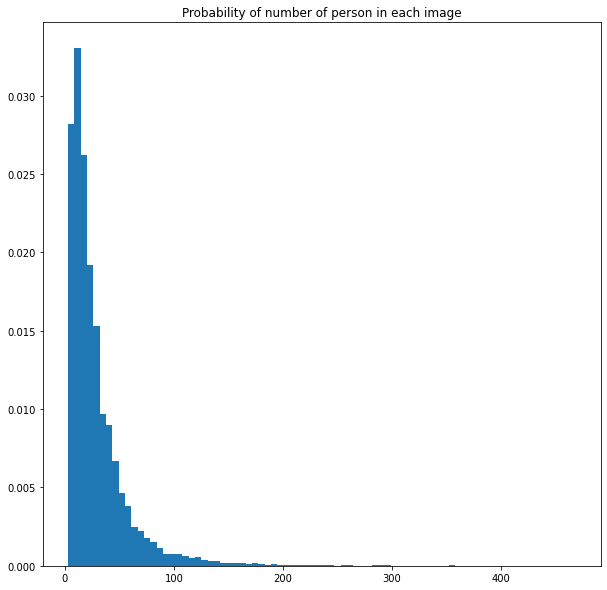

In [ ]:
plt.figure(figsize=(10,10))
plt.hist(np.array(df_train['Person count in image']), density=True, bins=80)
plt.title('Probability of number of person in each image')

In [ ]:
# Function to find SNR
def signaltonoise(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return np.where(sd == 0, 0, m/sd)

/content/YOLOv4_CrowdHuman/data


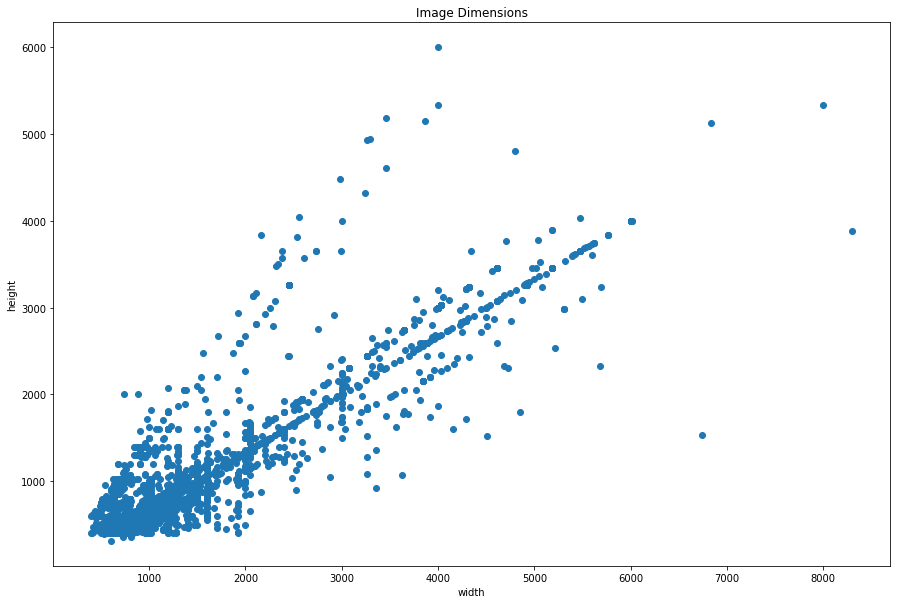

In [ ]:
%cd /content/YOLOv4_CrowdHuman/data
jpg_paths = list(Path('raw/Images').rglob('*.jpg'))
img_widths, img_heights = [], [] # store image width and height
images = []

for i, jpg_path in enumerate(jpg_paths):
    if i == 5000:
      break
    # read the image
    img = cv2.imread(jpg_path.as_posix())
    images.append(img)
    # image height, image width, image channel
    img_h, img_w, img_c = img.shape
    img_widths.append(img_w)
    img_heights.append(img_h)

img_widths = np.array(img_widths)
img_heights = np.array(img_heights)

plt.figure(figsize=(15, 10))
plt.subplot(1, 1, 1)
plt.scatter(img_widths, img_heights)
plt.title('Image Dimensions')
plt.xlabel('width')
plt.ylabel('height')

plt.show()

As you can see, taking sample of 5000 images shows us that most of the images are of 1000 x 1000 resolution or less than that.

<ipython-input-10-af715ea6a187>:6: RuntimeWarning: divide by zero encountered in true_divide
  return np.where(sd == 0, 0, m/sd)
<ipython-input-10-af715ea6a187>:6: RuntimeWarning: invalid value encountered in true_divide
  return np.where(sd == 0, 0, m/sd)


Text(0, 0.5, 'Mean SNR')

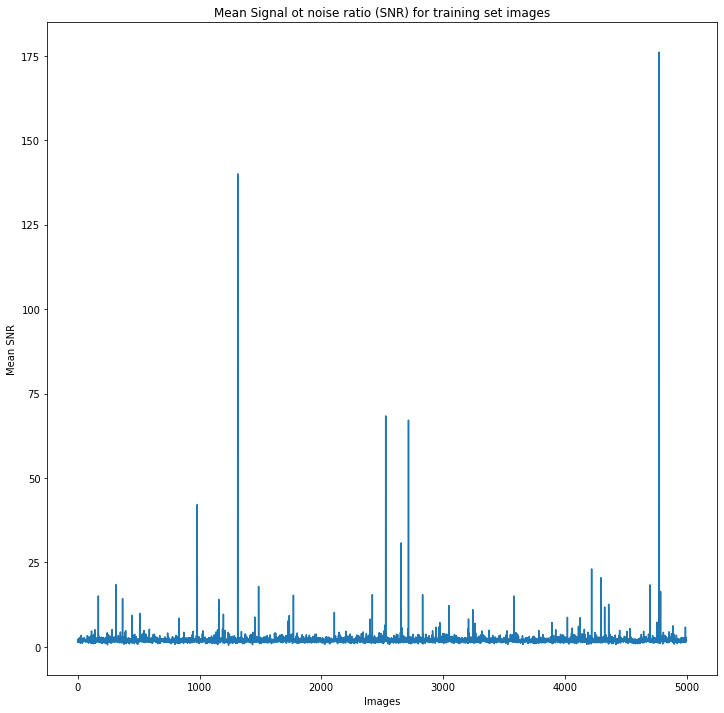

In [ ]:
snr_mean = []
for imgs in images:
  snr_mean.append(np.mean(signaltonoise(imgs)))

plt.figure(figsize=(12,12))
plt.plot([i for i in range(len(snr_mean))], snr_mean)
plt.title('Mean Signal ot noise ratio (SNR) for training set images')
plt.xlabel('Images')
plt.ylabel('Mean SNR')

As seen from the plot above most of the raw images have SNR closer to zero but there are some exceptions that is, the spikes in the plot with which can conclude that most of the images are clean with some noisy images here and there and rarely some images with very high noise. Thus, these images are good for training as most of the images have very less noise which is required so that the model can learn the features resulting in higher accuracy and precision.

**Model revision**

>**Model**: YOLO v4 is a one stage detector meaning the classes and the bounding boxes for the complete image is predicted instead of selecting region of interest (ROI). YOLO divides the object-detection task into regression task followed by a classification task. Regression predicts classes and bounding boxes for the whole image in single run and helps to identify the object position. Classification determines the object's class

>**Architecture**: The architecture consists of various parts: 
* The input which is the set of training images which will be fed to the network 
* The backbone is SPDarkNet53 based on the DenseNet design. It concatenates the previous inputs with the current input before proceeding into the dense layers.
CSPDarkNet53 consists of two blocks: Convolutional Base Layer  consisting of the full-sized input feature map and Cross Stage Partial (CSP) Block which is stacked next to the Convolutional Base layer, It divides the input into two halves, one half will be sent through the dense block, while the other half will be routed directly to the next step without any processing.
* The Neck which do the feature extraction and aggregation. The Detection Neck and Detection Head together can be called as the Object Detector. It collects feature maps from the different stages of the backbone then mixes and combines them to prepare them for the next step. Usually, a neck consists of several bottom-up paths and several top-down paths.
* An additional block called SPP (Spatial Pyramid Pooling) is added in between the CSPDarkNet53 backbone and the feature aggregator network (PANet). It is connected to the final layers of the densely connected convolutional layers of CSPDarkNet.
* The head's main function is to locate bounding boxes and performing classification. The bounding box co-ordinates (x, y, height and width) as well as scores are detected. Here the x and y co-ordinates are the center of the bounding box (b-box) expressed relative to the boundary of the grid cell, the width and height are predicted relative to the whole image.




**The code explanation**

> The code is uploaded on my [github repo](https://github.com/febinfredi/YOLOv4_CrowdHuman.git) and is downloaded to the runtime.

>

>**Download Darknet:**
Darknet is an open source neural network framework written in C and CUDA. It is fast, easy to install, and supports CPU and GPU computation and we will be using the yolov4 model

In [ ]:
%cd /content/YOLOv4_CrowdHuman
!rm -rf darknet
!git clone https://github.com/AlexeyAB/darknet.git

/content/YOLOv4_CrowdHuman
Cloning into 'darknet'...
remote: Enumerating objects: 15502, done.
remote: Total 15502 (delta 0), reused 0 (delta 0), pack-reused 15502
Receiving objects: 100% (15502/15502), 14.14 MiB | 27.07 MiB/s, done.
Resolving deltas: 100% (10406/10406), done.


In [ ]:
# Cmake or install the dependencies such as CUDA, cudnn, ZED, etc.
%cd /content/YOLOv4_CrowdHuman/darknet
!sed -i "1s/GPU=0/GPU=1/"               Makefile
!sed -i "2s/CUDNN=0/CUDNN=1/"           Makefile
!sed -i "3s/CUDNN_HALF=0/CUDNN_HALF=1/" Makefile
!sed -i "4s/OPENCV=0/OPENCV=1/"         Makefile
!sed -i "5s/AVX=0/AVX=1/"               Makefile
!sed -i "7s/LIBSO=0/LIBSO=1/"           Makefile
!sed -i "20s/compute_30,code=sm_30 \\\/compute_37,code=sm_37 -gencode arch=compute_60,code=[sm_60,compute_60] -gencode arch=compute_61,code=[sm_61,compute_61] -gencode arch=compute_75,code=[sm_75,compute_75]/" Makefile
!sed -i "21s/^/#/"                      Makefile
!sed -i "22s/^/#/"                      Makefile
!sed -i "23s/^/#/"                      Makefile
!sed -i "24s/^/#/"                      Makefile
# Set darknet test mAP frequency during training 
!sed -i "300s/calc_map_for_each = 4/calc_map_for_each = 1/" src/detector.c

!make

/content/YOLOv4_CrowdHuman/darknet
mkdir -p ./obj/
mkdir -p backup
chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -DCUDNN_HALF -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -ffp-contract=fast -mavx -mavx2 -msse3 -msse4.1 -msse4.2 -msse4a -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -DCUDNN_HALF -fPIC -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:946:23: warning: variable ‘rgb’ set but not used [-Wunused-but-set-variable]
                 float rgb[3];
                       ^~~
./src/image_opencv.cpp: In function ‘void draw_train_loss(char*, void**, int, float, float, int, int, float, int, char*, float, int, int, double)’:
./src/image_opencv.cpp:1147:13: warn

In [ ]:
# Create directories for saving train results
!mkdir -p "{DRIVE_SAVE_DIR}"
!rm -f "{DRIVE_SAVE_DIR}"/train.log
!touch "{DRIVE_SAVE_DIR}"/chart.png
!rm -f chart.png
!ln -sf "{DRIVE_SAVE_DIR}"/chart.png .
!mkdir -p "{DRIVE_SAVE_DIR}"/backup
!rm -rf backup
!ln -sf "{DRIVE_SAVE_DIR}"/backup .

**Run prepare_training.sh shell script**
```
<#!/bin/bash

set -e

# check argument
if [[ -z $1 || ! $1 =~ [[:digit:]]x[[:digit:]] ]]; then
  echo "ERROR: This script requires 1 argument, \"input dimension\" of the YOLO model."
  echo "The input dimension should be {width}x{height} such as 608x608 or 416x256.".
  exit 1
fi

CROWDHUMAN=crowdhuman-$1

if [[ ! -f data/${CROWDHUMAN}/train.txt || ! -f data/${CROWDHUMAN}/test.txt ]]; then
  echo "ERROR: missing txt file in data/${CROWDHUMAN}/"
  exit 1
fi

echo "** Install requirements"
# "gdown" is for downloading files from GoogleDrive
pip3 install --user gdown > /dev/null
pip3 install --upgrade gdown > /dev/null

echo "** Copy files for training"
ln -sf $(readlink -f data/${CROWDHUMAN}) darknet/data/
cp data/${CROWDHUMAN}.data darknet/data/
cp data/crowdhuman.names darknet/data/
cp cfg/*.cfg darknet/cfg/

if [[ ! -f darknet/yolov4.conv.137 ]]; then
  pushd darknet > /dev/null
  echo "** Download pre-trained yolov4 weights"
  python3 -m gdown.cli https://drive.google.com/uc?id=12KJMpNRwQ1Mjq-sqRtorI80hofI9aoGC
  popd > /dev/null
fi

echo "** Done."
```

> On running these shell script we first install gdown so that we can download the files from google drive, then we copy the training data files into the darknet data files namely 
* crowdhuman-template.data and crowdhuman.names

            ```
            classes = 2
            train   = data/crowdhuman-{width}x{height}/train.txt
            valid   = data/crowdhuman-{width}x{height}/test.txt
            names   = data/crowdhuman.names
            backup  = backup/
            ```
> Then we copy .cfg files which are the config files which describes the config parameters like batch, subdivisions, width=416, height=416, channels=3, inputs, max_chart_loss=20 for the network and momentum, learning_rate, max_batches etc. for training. 

> We also download the pre-trained yolov4 weights from the drive









**.cfg file for yolov4-crowdhuman-416x416**
> This is the config file for our model located in path="/content/YOLOv4_CrowdHuman/darknet/cfg/yolov4-crowdhuman-416x416.cfg" which defines the parameters and architecture for the yolov4 model

```
[net]
# Training
batch=24
subdivisions=8
# Testing
#batch=1
#subdivisions=1
width=416
height=416
channels=3
momentum=0.949
decay=0.0005
angle=0
saturation = 1.5
exposure = 1.5
hue=.1

learning_rate=0.001
burn_in=1000
max_batches=4000
policy=steps
steps=3000,3600
scales=.1,.1

max_chart_loss=40.0

#cutmix=1
mosaic=1

#:104x104 54:52x52 85:26x26 104:13x13 for 416

[convolutional]
batch_normalize=1
filters=32
size=3
stride=1
pad=1
activation=mish

# Downsample

[convolutional]
batch_normalize=1
filters=64
size=3
stride=2
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

[route]
layers = -2

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=32
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=64
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

[route]
layers = -1,-7

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

# Downsample

[convolutional]
batch_normalize=1
filters=128
size=3
stride=2
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

[route]
layers = -2

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=64
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=64
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=64
size=1
stride=1
pad=1
activation=mish

[route]
layers = -1,-10

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

# Downsample

[convolutional]
batch_normalize=1
filters=256
size=3
stride=2
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[route]
layers = -2

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=128
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=mish

[route]
layers = -1,-28

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

# Downsample

[convolutional]
batch_normalize=1
filters=512
size=3
stride=2
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[route]
layers = -2

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear


[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=256
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=mish

[route]
layers = -1,-28

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=mish

# Downsample

[convolutional]
batch_normalize=1
filters=1024
size=3
stride=2
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=mish

[route]
layers = -2

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=mish

[convolutional]
batch_normalize=1
filters=512
size=3
stride=1
pad=1
activation=mish

[shortcut]
from=-3
activation=linear

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=mish

[route]
layers = -1,-16

[convolutional]
batch_normalize=1
filters=1024
size=1
stride=1
pad=1
activation=mish
stopbackward=800

##########################

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=1024
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

### SPP ###
[maxpool]
stride=1
size=5

[route]
layers=-2

[maxpool]
stride=1
size=9

[route]
layers=-4

[maxpool]
stride=1
size=13

[route]
layers=-1,-3,-5,-6
### End SPP ###

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=1024
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[upsample]
stride=2

[route]
layers = 85

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[route]
layers = -1, -3

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=512
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=512
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[upsample]
stride=2

[route]
layers = 54

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[route]
layers = -1, -3

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=256
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=256
activation=leaky

[convolutional]
batch_normalize=1
filters=128
size=1
stride=1
pad=1
activation=leaky

##########################

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=256
activation=leaky

[convolutional]
size=1
stride=1
pad=1
filters=21
activation=linear


[yolo]
mask = 0,1,2
anchors = 9,18,  17,45,  26,84,  38,132,  48,188,  62,256,  87,338,  133,215,  192,355
classes=2
num=9
jitter=.3
ignore_thresh = .7
truth_thresh = 1
random=1
scale_x_y = 1.2
iou_thresh=0.213
cls_normalizer=1.0
iou_normalizer=0.07
iou_loss=ciou
nms_kind=greedynms
beta_nms=0.6
max_delta=5


[route]
layers = -4

[convolutional]
batch_normalize=1
size=3
stride=2
pad=1
filters=256
activation=leaky

[route]
layers = -1, -16

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=512
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=512
activation=leaky

[convolutional]
batch_normalize=1
filters=256
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=512
activation=leaky

[convolutional]
size=1
stride=1
pad=1
filters=21
activation=linear


[yolo]
mask = 3,4,5
anchors = 9,18,  17,45,  26,84,  38,132,  48,188,  62,256,  87,338,  133,215,  192,355
classes=2
num=9
jitter=.3
ignore_thresh = .7
truth_thresh = 1
random=1
scale_x_y = 1.1
iou_thresh=0.213
cls_normalizer=1.0
iou_normalizer=0.07
iou_loss=ciou
nms_kind=greedynms
beta_nms=0.6
max_delta=5


[route]
layers = -4

[convolutional]
batch_normalize=1
size=3
stride=2
pad=1
filters=512
activation=leaky

[route]
layers = -1, -37

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=1024
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=1024
activation=leaky

[convolutional]
batch_normalize=1
filters=512
size=1
stride=1
pad=1
activation=leaky

[convolutional]
batch_normalize=1
size=3
stride=1
pad=1
filters=1024
activation=leaky

[convolutional]
size=1
stride=1
pad=1
filters=21
activation=linear


[yolo]
mask = 6,7,8
anchors = 9,18,  17,45,  26,84,  38,132,  48,188,  62,256,  87,338,  133,215,  192,355
classes=2
num=9
jitter=.3
ignore_thresh = .7
truth_thresh = 1
random=1
scale_x_y = 1.05
iou_thresh=0.213
cls_normalizer=1.0
iou_normalizer=0.07
iou_loss=ciou
nms_kind=greedynms
beta_nms=0.6
max_delta=5


```



In [ ]:
%cd /content/YOLOv4_CrowdHuman
! chmod +x prepare_training.sh
!./prepare_training.sh {INPUT_SHAPE}

/content/YOLOv4_CrowdHuman
** Install requirements
** Copy files for training
** Download pre-trained yolov4 weights
Downloading...
From: https://drive.google.com/uc?id=12KJMpNRwQ1Mjq-sqRtorI80hofI9aoGC
To: /content/YOLOv4_CrowdHuman/darknet/yolov4.conv.137
100% 170M/170M [00:03<00:00, 55.6MB/s]
** Done.


**Training the model**

In [ ]:
%cd /content/YOLOv4_CrowdHuman/darknet
!./darknet detector train data/crowdhuman-{INPUT_SHAPE}.data cfg/yolov4-crowdhuman-{INPUT_SHAPE}.cfg yolov4.conv.137 -gpus 0 -map -dont_show 2>&1 | tee "{DRIVE_SAVE_DIR}"/train.log | grep -E "hours left|mean_average"

Streaming output truncated to the last 5000 lines.
 (next mAP calculation at 2500 iterations) ]2;1502/4000: loss=26.1 hours left=0.6
 1502: 26.074112, 27.569605 avg loss, 0.001000 rate, 0.644766 seconds, 36048 images, 0.604269 hours left
 (next mAP calculation at 2500 iterations) ]2;1503/4000: loss=24.7 hours left=0.6
 1503: 24.661123, 27.278757 avg loss, 0.001000 rate, 0.719298 seconds, 36072 images, 0.603394 hours left
 (next mAP calculation at 2500 iterations) ]2;1504/4000: loss=30.4 hours left=0.6
 1504: 30.391230, 27.590004 avg loss, 0.001000 rate, 0.648716 seconds, 36096 images, 0.602349 hours left
 (next mAP calculation at 2500 iterations) ]2;1505/4000: loss=17.1 hours left=0.6
 1505: 17.135107, 26.544514 avg loss, 0.001000 rate, 0.598206 seconds, 36120 images, 0.600824 hours left
 (next mAP calculation at 2500 iterations) ]2;1506/4000: loss=20.7 hours left=0.6
 1506: 20.688095, 25.958872 avg loss, 0.001000 rate, 0.643753 seconds, 36144 images, 0.598962 hours left
 (ne

In [ ]:
from IPython.display import *
import os

# Predict Images
!./darknet detector test data/crowdhuman-{INPUT_SHAPE}.data cfg/yolov4-crowdhuman-{INPUT_SHAPE}.cfg backup/yolov4-crowdhuman-{INPUT_SHAPE}_best.weights data/crowdhuman-{INPUT_SHAPE}/273271,109db000477d4466.jpg -gpus 0 -ext_output prediction1.jpg -dont_show
os.rename("/content/YOLOv4_CrowdHuman/darknet/predictions.jpg", "/content/YOLOv4_CrowdHuman/darknet/predict1.jpg")
!./darknet detector test data/crowdhuman-{INPUT_SHAPE}.data cfg/yolov4-crowdhuman-{INPUT_SHAPE}.cfg backup/yolov4-crowdhuman-{INPUT_SHAPE}_best.weights data/crowdhuman-{INPUT_SHAPE}/273271,11b63000fdfc5d9d.jpg -gpus 0 -out_filename prediction2.jpg -dont_show
os.rename("/content/YOLOv4_CrowdHuman/darknet/predictions.jpg", "/content/YOLOv4_CrowdHuman/darknet/predict2.jpg")
!./darknet detector test data/crowdhuman-{INPUT_SHAPE}.data cfg/yolov4-crowdhuman-{INPUT_SHAPE}.cfg backup/yolov4-crowdhuman-{INPUT_SHAPE}_best.weights data/crowdhuman-{INPUT_SHAPE}/273271,123a400011ae5f9d.jpg -gpus 0 -out_filename prediction3.jpg -dont_show
os.rename("/content/YOLOv4_CrowdHuman/darknet/predictions.jpg", "/content/YOLOv4_CrowdHuman/darknet/predict3.jpg")
!./darknet detector test data/crowdhuman-{INPUT_SHAPE}.data cfg/yolov4-crowdhuman-{INPUT_SHAPE}.cfg backup/yolov4-crowdhuman-{INPUT_SHAPE}_best.weights data/crowdhuman-{INPUT_SHAPE}/273271,22c84000744abf1f.jpg -gpus 0 -out_filename prediction4.jpg -dont_show
os.rename("/content/YOLOv4_CrowdHuman/darknet/predictions.jpg", "/content/YOLOv4_CrowdHuman/darknet/predict4.jpg")

 CUDA-version: 11020 (11020), cuDNN: 8.1.1, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
0
 0 : compute_capability = 800, cudnn_half = 1, GPU: A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     64       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  64 0.354 BF
   3 route  1 		                           ->  208 x 208 x  64 
   4 conv     64       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  64 0.354 BF
   5 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   6 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   8

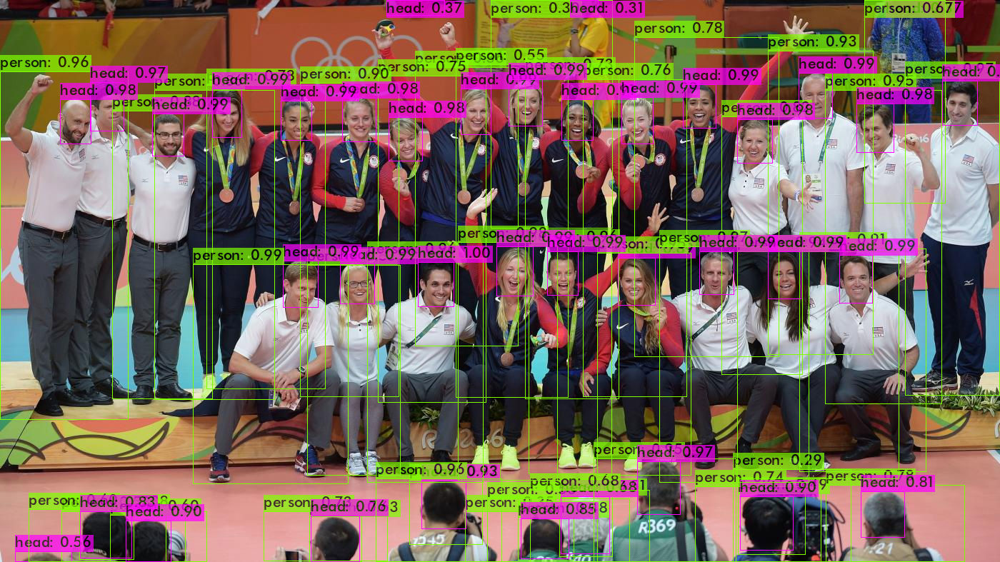

In [ ]:
Image("/content/YOLOv4_CrowdHuman/darknet/predict1.jpg")

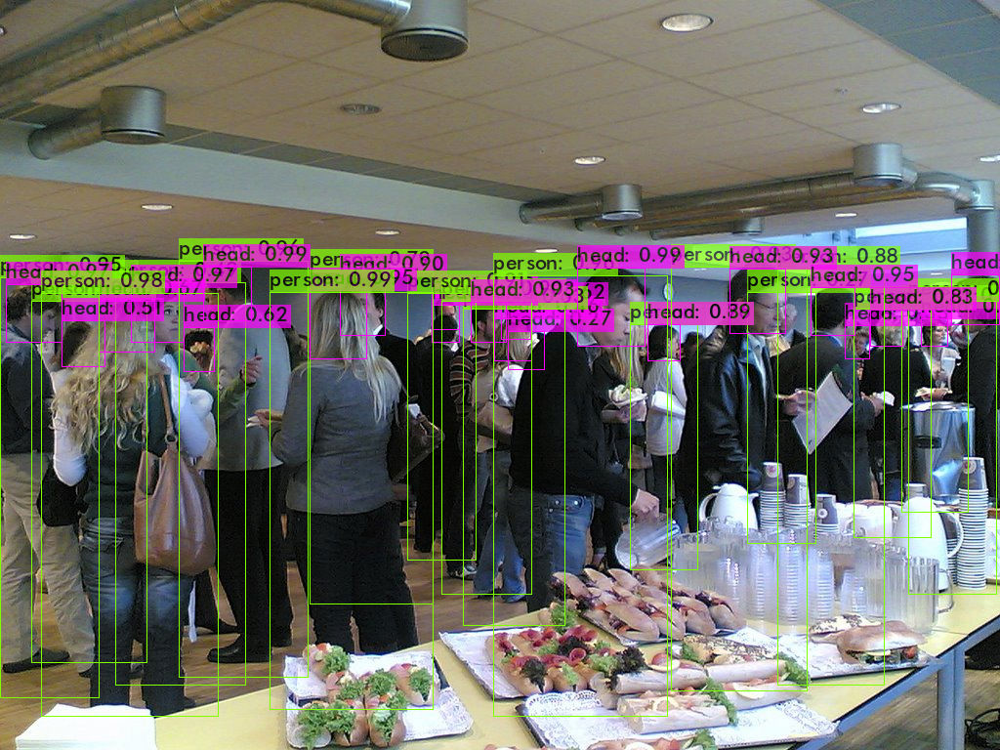

In [ ]:
Image("/content/YOLOv4_CrowdHuman/darknet/predict2.jpg")

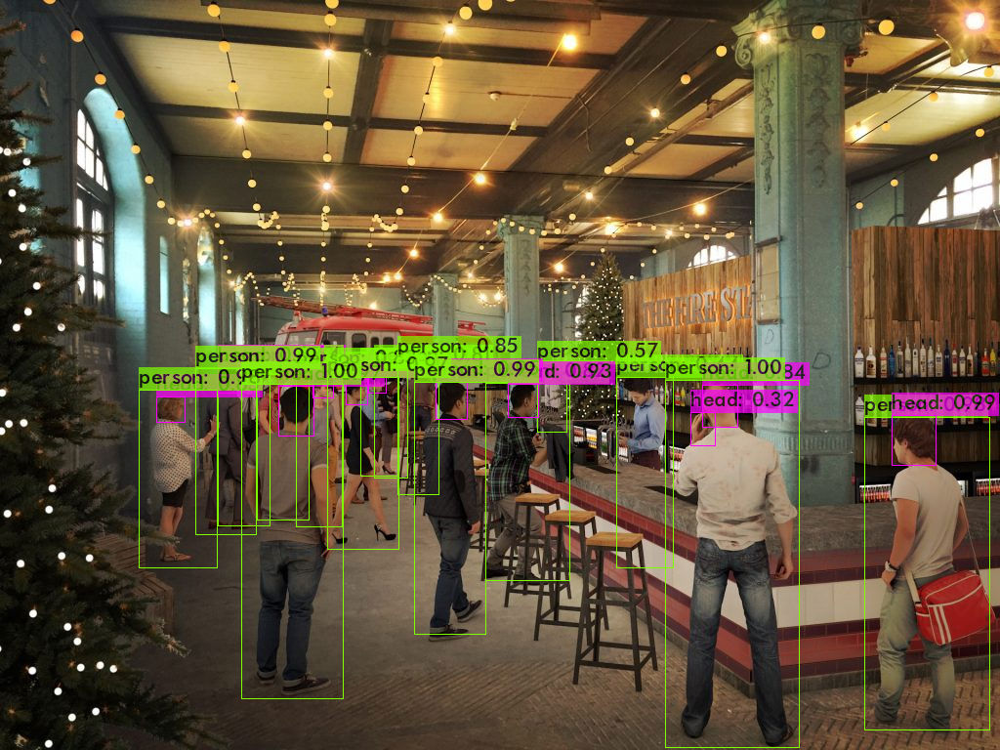

In [ ]:
Image("/content/YOLOv4_CrowdHuman/darknet/predict3.jpg")

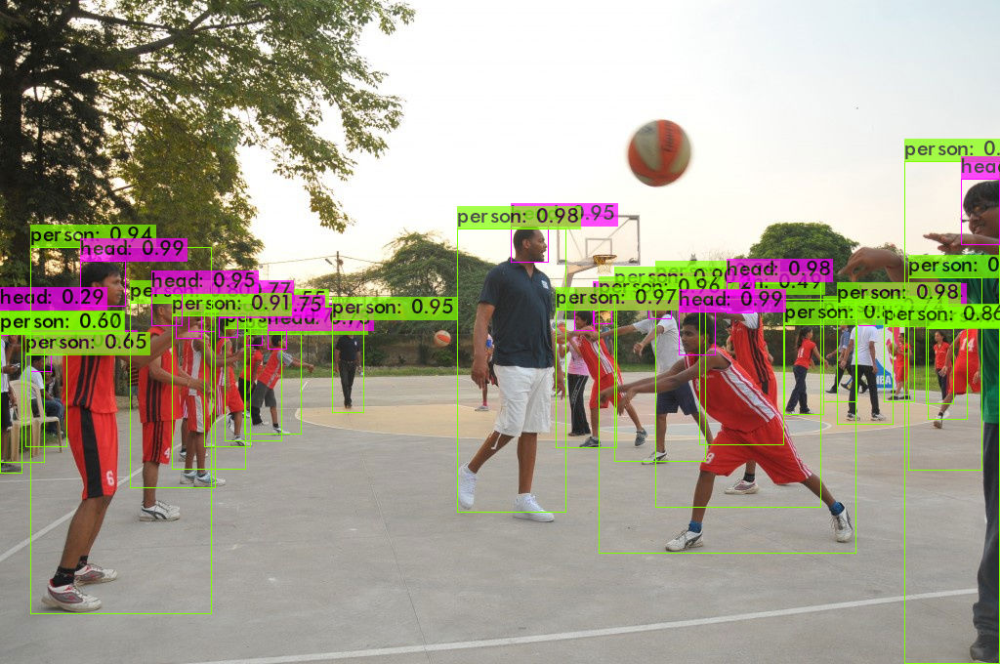

In [ ]:
Image("/content/YOLOv4_CrowdHuman/darknet/predict4.jpg")

In [ ]:
# Predic videos
!./darknet detector demo data/crowdhuman-{INPUT_SHAPE}.data cfg/yolov4-crowdhuman-{INPUT_SHAPE}.cfg backup/yolov4-crowdhuman-{INPUT_SHAPE}_best.weights -dont_show /content/Pexels_Videos.mp4 -i 0 -out result.json -out_filename output.avi -ext_output -dont_show 
# os.rename("/content/YOLOv4_CrowdHuman/darknet/predictions.jpg", "/content/YOLOv4_CrowdHuman/darknet/predict4.jpg")

Streaming output truncated to the last 5000 lines.
person: 33% 	(left_x: 1295   top_y:  662   width:   85   height:  214)
head: 98% 	(left_x:   30   top_y:  592   width:  128   height:  124)
head: 95% 	(left_x:  300   top_y:  568   width:   49   height:   54)
head: 93% 	(left_x: 1357   top_y:  647   width:   48   height:   57)
head: 92% 	(left_x: 1256   top_y:  678   width:   53   height:   69)
head: 86% 	(left_x:  522   top_y:  643   width:   71   height:   90)
head: 86% 	(left_x:  589   top_y:  640   width:   52   height:   52)
head: 80% 	(left_x:  227   top_y:  667   width:   68   height:   71)
head: 78% 	(left_x:  827   top_y:  668   width:   48   height:   56)
head: 66% 	(left_x:  757   top_y:  661   width:   50   height:   52)
head: 64% 	(left_x: 1322   top_y:  657   width:   38   height:   44)
head: 62% 	(left_x: 1043   top_y:  667   width:   39   height:   42)
head: 57% 	(left_x:  303   top_y:  519   width:   46   height:   53)
head: 55% 	(left_x: 1197   top_y:  688   width:   

In [ ]:
pip install imageio-ffmpeg

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 26.9 MB 101.3 MB/s 


In [ ]:
!ffmpeg -i /content/YOLOv4_CrowdHuman/darknet/output.avi /content/YOLOv4_CrowdHuman/darknet/output.mp4

ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

In [ ]:
# Install kora for uploading files to drive
#!pip install -U kora

In [ ]:
from kora.drive import upload_public
url = upload_public('/content/YOLOv4_CrowdHuman/darknet/output.mp4')

In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/YOLOv4_CrowdHuman/darknet/output.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

**Checking accuracy mAP@IoU=75**

In [ ]:
!./darknet detector map data/crowdhuman-{INPUT_SHAPE}.data cfg/yolov4-crowdhuman-{INPUT_SHAPE}.cfg backup/yolov4-crowdhuman-{INPUT_SHAPE}_best.weights -iou_thresh 0.75

 CUDA-version: 11020 (11020), cuDNN: 8.1.1, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 800, cudnn_half = 1, GPU: A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     64       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  64 0.354 BF
   3 route  1 		                           ->  208 x 208 x  64 
   4 conv     64       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  64 0.354 BF
   5 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   6 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   8 c

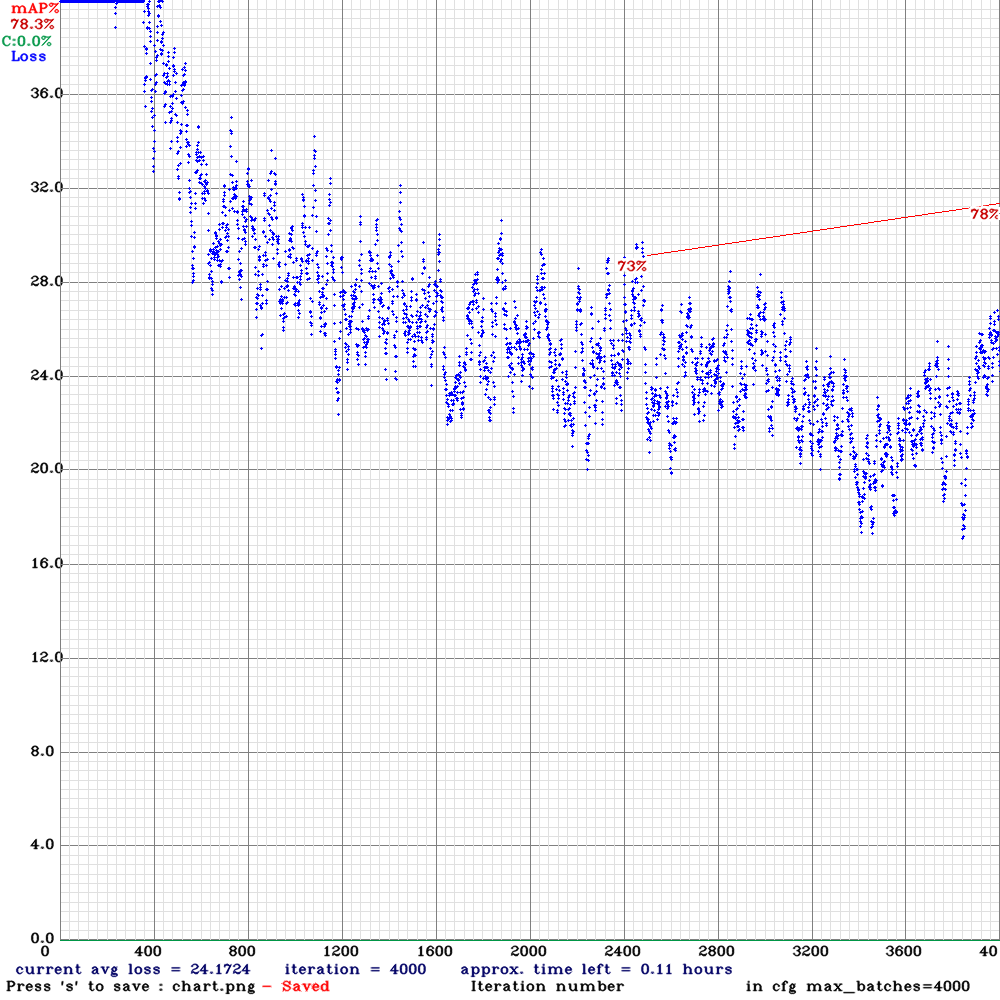

In [ ]:
TRAIN_CHART_PATH = "/content/drive/MyDrive/yolov4_crowdhuman/chart.png"
Image(TRAIN_CHART_PATH)

# **Final Analysis**
> In conclusion, our goal was to train model to detect humans in crowded scenarios and we were able to achieve this goal. The YOLOv4 model was chosen for this task and the training was done on CrowdHuman dataset containing 15,000 training set images, 4370 validation set images and 5000 training images. Initial EDA on the dataset revealed that on average, there are 29 count of humans in training set image and most of the images are of 1000 x 1000 resolution or less with very low SNR mostly. The dataset images were converted to 416x416 size, as bigge size will require higher training time and the training computation load.

> The YOLOv4 model, built using darknet was successfully trained on the dataset, which took approximately 2 hours while using A100-SXM4-40GB GPU on colab. The training parameter were as follow: 
*   Iterations = 4000
*   Height x Width = 416 x 416
*   Weights = Pretrained 
*   Classes = 2
*   IoU thresh = 0.213
*   Max delta = 5 

#### **Result Analysis**

> The model has mAP of 78% at IoU @ 0.5 and average loss of 24%. The model was tested by giving it random images, on which it was able to perfectly detect the humans and the head. There were instances where model predicted either human or head but not both. The model was also tetsed on a 13 sec video of an Indian market, where it was properly able to detect both human and head class with a fps of 30. 

#### **Inference**

> On comparing the performance of our model, which was trained on CrowdHuman dataset against other models trained on default COCO dataset, our model performed better in detecting humans in crowded scenarios (specifically in crowded scenarios), though performance was comparable in other situations though. So, the following conclusions can be drawn the results:

* Quality of dataset is an important factor than quantity: Even though the default COCO dataset had 64,000 images compared to 15,000 images in CrowdHuman dataset, performance was better in CrowdHuman due to the larger volume, density and diversity of human instances.

* Higher batch size will increases training speed but may result in lower quality model: If your GPU is powerful enough, a lower batch size is better as it will increase the quality of the model.

* Comparing with latest YOLO models (v5 and v7): Improving architecture is the best way to increase the performance, evident from the recent YOLO versions like v7.

* Higher resolution images are better: We downsized images to 416 x 416 from 1000 x 1000 to make training complexity less, whcih also affected the feature maps as better resolution we have of the images, more feature data can be extracted for the model training.

* Initial weight file used during training were pre trained weight file, which was further changed while training on the CrowdHuman dataset, resulting in performance of the model we observed here. This result was observed maybe because initial weight file was used for detecting 80 classes, one of which was human, which might have helped in the optimizing the weights further by training on CrowdHuman dataset, which is specifically for human detection.

#### **Conclusion**

> In this project, we were able to train a YOLOv4 model to detect humans in crowded scenarios satisfactorily. The model was tested on images and videos and was able to detect humans in both cases, and video output was also at a stable average 30 FPS. There are still improvements which can introduced for better performance, but the result we obtained in this project is satisfactorily enough to be used for future works we planned like using this model in aiding robots to navigate among humans.   